# California Elections and historic trends

## A serious analysis from 2002 to 2022 <19-20 years> 

#### This project is meant to explore, in a detailed fashion, how statewide and federal elections have played out in the state of California, and aiming to see some of the internal shifts within the state to see where we could be headed next. 

In [15]:
#Importing all relevant libraries and frameworks

import geopandas as gp
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import libpysal
import mapclassify

import warnings
warnings.filterwarnings('ignore')


In [16]:
## Downloading all the relevant data for our work from the statewide database

## State boundaries and lines

states_df = gp.read_file("https://datascience.quantecon.org/assets/data/cb_2016_us_state_5m.zip")

## California specific statewide precinct shapefiles (Like below, link all relevant files we need to work with and download via curl on map-data directory)

ca_precincts_G20 = gp.read_file("/home/chints98/python-books/map-data/g20_shp.zip")
#ca_precincts_P20 = gp.read_file("/home/chints98/python-books/map-data/p20_shp.zip") <Don't need primary precincts?>

## California specific statewide precinct SOV data

ca_results_df_P20 = gp.read_file("/home/chints98/python-books/map-data/p20_data.zip")
ca_results_df_G20 = gp.read_file("/home/chints98/python-books/map-data/g20_data.zip")


In [17]:
def intersection (l1, l2): 
    resultList = [v for v in l1 if v in l2]
    return resultList

In [18]:
##Get registration data for 2020. 

ca_reg20 = gp.read_file("/home/chints98/python-books/map-data/ca20_reg.zip")

ca_reg20

ca_results_df_G20.head()

## Find intersection of these two columns and then delete those before merging?

regList = list(ca_reg20.columns)
resList = list(ca_results_df_G20)

mergeList = intersection(regList,resList)


## Clean up registration file before merging into a new copy of final merge. 
# 
#  

ca_reg20 = ca_reg20.drop(columns=['FIPS', 'SRPREC', 'geometry', 'COUNTY'])

print(mergeList)

['COUNTY', 'FIPS', 'SRPREC_KEY', 'SRPREC', 'geometry']


###### The first elections we'll explore are the ones that happened most recently, in 2021 (Governor recall). Whilst partisanship remained similar to 2018 in terms of margin, there were quite a few interesting changes under the hood in terms of coalitions, and it'd be interesting to compare to 2020 pres, 2018 gov, and 2016 pres to get a snapshot of where the state is currently at. 


###### * current 2021 recall data is incomplete, therefore we will begin with identifying trends from 2020 and analyzing onwards from there. We will also be analyzing the shape of the Democratic party primaries, as we want to see the real conflict in the state, which is really between moderate and progressive democrats

In [23]:
#Quick map plot of california with precinct lines

x, y = plt.subplots(figsize=(200,200))
states_df.query("NAME == 'CALIFORNIA'").plot(ax=y,edgecolor='grey', alpha=1,color='grey')
ca_precincts_G20.plot(ax=y,edgecolor='white', alpha=0.125, color='black')

<AxesSubplot:>

In [24]:
## Clean up results dataframes to only have voter data + numbers including SRPREC
ca_results_df_G20.head()

ca_results_G20 = ca_results_df_G20.drop(columns=['geometry', 'COUNTY', 'SRPREC'])

ca_G20_combined = ca_precincts_G20.merge(ca_results_G20, left_on="SRPREC_KEY", right_on="SRPREC_KEY", how="inner")
ca_G20_combined.shape
ca_G20_combined.columns


##Converting str to integer for all indices that are meant to denote a count metric (Vote, registration)
ca_G20_combined[['TOTREG',
       'DEMREG', 'REPREG', 'AIPREG', 'GRNREG', 'LIBREG', 'NLPREG', 'REFREG',
       'DCLREG', 'MSCREG', 'TOTVOTE', 'DEMVOTE', 'REPVOTE', 'AIPVOTE',
       'GRNVOTE', 'LIBVOTE', 'NLPVOTE', 'REFVOTE', 'DCLVOTE', 'MSCVOTE',
       'PRCVOTE', 'ABSVOTE', 'ASSDEM01', 'ASSDEM02', 'ASSGRN01', 'ASSIND01',
       'ASSLIB01', 'ASSREP01', 'ASSREP02', 'CNGDEM01', 'CNGDEM02', 'CNGREP01',
       'PRSAIP01', 'PRSDEM01', 'PRSGRN01', 'PRSLIB01', 'PRSPAF01', 'PRSREP01',
       'PR_14_N', 'PR_14_Y', 'PR_15_N', 'PR_15_Y', 'PR_16_N', 'PR_16_Y',
       'PR_17_N', 'PR_17_Y', 'PR_18_N', 'PR_18_Y', 'PR_19_N', 'PR_19_Y',
       'PR_20_N', 'PR_20_Y', 'PR_21_N', 'PR_21_Y', 'PR_22_N', 'PR_22_Y',
       'PR_23_N', 'PR_23_Y', 'PR_24_N', 'PR_24_Y', 'PR_25_N', 'PR_25_Y',
       'SENAIP01', 'SENDEM01', 'SENDEM02', 'SENLIB01', 'SENREP01']]=ca_G20_combined[['TOTREG',
       'DEMREG', 'REPREG', 'AIPREG', 'GRNREG', 'LIBREG', 'NLPREG', 'REFREG',
       'DCLREG', 'MSCREG', 'TOTVOTE', 'DEMVOTE', 'REPVOTE', 'AIPVOTE',
       'GRNVOTE', 'LIBVOTE', 'NLPVOTE', 'REFVOTE', 'DCLVOTE', 'MSCVOTE',
       'PRCVOTE', 'ABSVOTE', 'ASSDEM01', 'ASSDEM02', 'ASSGRN01', 'ASSIND01',
       'ASSLIB01', 'ASSREP01', 'ASSREP02', 'CNGDEM01', 'CNGDEM02', 'CNGREP01',
       'PRSAIP01', 'PRSDEM01', 'PRSGRN01', 'PRSLIB01', 'PRSPAF01', 'PRSREP01',
       'PR_14_N', 'PR_14_Y', 'PR_15_N', 'PR_15_Y', 'PR_16_N', 'PR_16_Y',
       'PR_17_N', 'PR_17_Y', 'PR_18_N', 'PR_18_Y', 'PR_19_N', 'PR_19_Y',
       'PR_20_N', 'PR_20_Y', 'PR_21_N', 'PR_21_Y', 'PR_22_N', 'PR_22_Y',
       'PR_23_N', 'PR_23_Y', 'PR_24_N', 'PR_24_Y', 'PR_25_N', 'PR_25_Y',
       'SENAIP01', 'SENDEM01', 'SENDEM02', 'SENLIB01', 'SENREP01']].apply(pd.to_numeric)

In [43]:
ca_20REGTOTAL = ca_G20_combined.merge(ca_reg20,left_on="SRPREC_KEY",right_on="SRPREC_KEY", how="inner")

In [44]:
pd.set_option("display.max_columns", 230)
ca_20REGTOTAL

,SRPREC,COUNTY,SRPREC_KEY,PREC_TYPE,ELECTION_x,FIPS_CODE,geometry,FIPS,ADDIST,CDDIST,SDDIST,BEDIST,TOTREG,DEMREG,REPREG,AIPREG,GRNREG,LIBREG,NLPREG,REFREG,DCLREG,MSCREG,TOTVOTE,DEMVOTE,REPVOTE,AIPVOTE,GRNVOTE,LIBVOTE,NLPVOTE,REFVOTE,DCLVOTE,MSCVOTE,PRCVOTE,ABSVOTE,ASSDEM01,ASSDEM02,ASSGRN01,ASSIND01,ASSLIB01,ASSREP01,ASSREP02,CNGDEM01,CNGDEM02,CNGREP01,PRSAIP01,PRSDEM01,PRSGRN01,PRSLIB01,PRSPAF01,PRSREP01,PR_14_N,PR_14_Y,PR_15_N,PR_15_Y,PR_16_N,PR_16_Y,PR_17_N,PR_17_Y,PR_18_N,PR_18_Y,PR_19_N,PR_19_Y,PR_20_N,PR_20_Y,PR_21_N,PR_21_Y,PR_22_N,PR_22_Y,PR_23_N,PR_23_Y,PR_24_N,PR_24_Y,PR_25_N,PR_25_Y,SENAIP01,SENDEM01,SENDEM02,SENLIB01,SENREP01,ELECTION_y,TYPE,TOTREG_R,DEM,REP,AIP,PAF,MSC,LIB,NLP,GRN,REF,DCL,MALE,FEMALE,HISPDEM,HISPREP,HISPDCL,HISPOTH,JEWDEM,JEWREP,JEWDCL,JEWOTH,KORDEM,KORREP,KORDCL,KOROTH,JPNDEM,JPNREP,JPNDCL,JPNOTH,CHIDEM,CHIREP,CHIDCL,CHIOTH,INDDEM,INDREP,INDDCL,INDOTH,VIETDEM,VIETREP,VIETDCL,VIETOTH,FILDEM,FILREP,FILDCL,FILOTH,DEMMUNK,DEMM1824,DEMM2534,DEMM3544,DEMM4554,DEMM5564,DEMM65PL,DEMFUNK,DEMF1824,DEMF2534,DEMF3544,DEMF4554,DEMF5564,DEMF65PL,REPMUNK,REPM1824,REPM2534,REPM3544,REPM4554,REPM5564,REPM65PL,REPFUNK,REPF1824,REPF2534,REPF3544,REPF4554,REPF5564,REPF65PL,DCLMUNK,DCLM1824,DCLM2534,DCLM3544,DCLM4554,DCLM5564,DCLM65PL,DCLFUNK,DCLF1824,DCLF2534,DCLF3544,DCLF4554,DCLF5564,DCLF65PL,OTHMUNK,OTHM1824,OTHM2534,OTHM3544,OTHM4554,OTHM5564,OTHM65PL,OTHFUNK,OTHF1824,OTHF2534,OTHF3544,OTHF4554,OTHF5564,OTHF65PL,DREG1G,DREG2G,DREG3G,DREG4G,DREG5G,DREG6G,DREG7G,DREG8G,DREG9G,RREG1G,RREG2G,RREG3G,RREG4G,RREG5G,RREG6G,RREG7G,RREG8G,RREG9G,IREG1G,IREG2G,IREG3G,IREG4G,IREG5G,IREG6G,IREG7G,IREG8G,IREG9G,OREG1G,OREG2G,OREG3G,OREG4G,OREG5G,OREG6G,OREG7G,OREG8G,OREG9G
0,10020,087,0608710020,SRPREC,g20,06087,"POLYGON ((-121.99575 36.97247, -121.99617 36.9...",06087,29,20,17,2,3527,0,0,0,0,0,0,0,0,0,3093,0,0,0,0,0,0,0,0,0,0,0,2351,0,0,0,0,595,0,2471,0,524,5,2487,15,30,15,498,1218,1705,1194,1787,1356,1566,745,2249,1252,1737,1237,1653,2094,772,1522,1400,1571,1355,1780,1099,1273,1618,1154,1681,0,2381,0,0,596,g20,R,3558,2142,442,75,8,26,28,1,31,0,805,1759,1799,282,42,101,18,117,25,43,8,2,0,0,0,5,0,2,0,11,7,5,0,12,2,3,1,6,1,0,0,19,1,9,1,0,88,184,132,115,151,281,0,94,189,171,139,196,402,0,15,29,21,44,56,81,0,4,17,14,25,39,97,0,62,105,85,67,65,81,0,38,68,57,55,54,68,0,7,22,13,14,19,22,0,8,19,12,8,9,16,1110,273,197,64,82,43,67,31,275,221,63,35,9,15,7,10,5,77,403,153,82,23,32,20,24,10,58,90,19,19,10,11,4,3,1,12
1,10091,087,0608710091,SRPREC,g20,06087,"POLYGON ((-121.98960 36.98153, -121.98911 36.9...",06087,29,20,17,2,3418,0,0,0,0,0,0,0,0,0,2955,0,0,0,0,0,0,0,0,0,0,0,2323,0,0,0,0,509,0,2406,0,460,16,2393,25,27,7,446,1119,1692,1088,1764,1263,1549,739,2137,1201,1669,1173,1598,2020,759,1364,1444,1523,1291,1643,1144,1196,1596,1187,1550,0,2332,0,0,521,g20,R,3450,2091,391,73,13,19,30,0,26,3,804,1724,1726,406,44,131,20,104,6,40,8,6,0,5,0,11,3,0,2,16,6,10,2,8,0,10,1,8,2,7,0,28,7,16,0,0,108,172,155,143,154,197,0,107,180,212,196,205,262,0,15,24,30,38,60,68,0,9,7,18,21,35,66,0,55,108,98,73,61,72,0,45,69,63,54,57,49,0,19,17,20,11,11,15,0,6,14,13,9,14,15,1111,257,186,41,83,49,69,19,276,194,37,30,15,11,5,12,7,80,354,165,84,28,46,18,33,17,59,96,26,12,2,7,7,1,4,9
2,10120,087,0608710120,SRPREC,g20,06087,"POLYGON ((-121.97106 36.98324, -121.97146 36.9...",06087,29,20,17,2,3673,0,0,0,0,0,0,0,0,0,3217,0,0,0,0,0,0,0,0,0,0,0,2472,0,0,0,0,604,0,2541,0,581,8,2524,21,27,9,576,1303,1722,1232,1859,1459,1584,882,2226,1427,1670,1260,1749,2110,873,1543,1472,1557,1492,1852,1193,1324,1666,1351,1614,0,2435,0,0,665,g20,R,3697,2234,533,78,15,27,36,0,25,0,749,1708,1989,421,50,123,25,99,21,33,6,5,1,0,1,12,0,5,0,22,5,13,0,8,3,8,2,8,0,1,0,15,2,10,1,0,74,141,137,117,159,271,0,108,174,169,159,219,506,0,22,31,20,33,58,109,0,8,18,24,26,46,138,0,53,98,69,71,46,92,0,27,60,52,50,56,75,0,11,23,12,17,25,19,0,5,8,13,11,13,24,1138,278,206,56,76,52,67,28,333,238,74,46,15,23,10,16,6,105,336,147,64,26,47,16,34,9,70,112,27,18,5,1,1,4,1,12
3,10142,087,0608710142,SRPREC,g20,06087,"MULTI

In [45]:
x, y = plt.subplots(figsize=(500,320))

ca_G20_combined.plot(ax=y,edgecolor='black', alpha=0.75, color='white')

<AxesSubplot:>

### Exploring the 2020 presidential results in California, then comparing them to downballot races in different regions of the state.

In [46]:
#Check shape of combined frame via using head
#ca_G20_combined.head()


## test out formula for assigning winner to precinct and assigning a voteshare in CA-52 <my current district>.

##CD 52 is a classic example of an old Republican stronghold where Bush did very well and used to send GOP folks to Washington. Now represented by Scott Peters.

CD52_results = ca_G20_combined.query('CDDIST == "52"')
CD52_results.columns


## We should be calculating the vote share of each party within the congressional district. We only have two parties for this. 
## First, calculate the congressional vote total
CD52_results['CDVOTE'] = CD52_results['CNGDEM01'] + CD52_results['CNGREP01']
CD52_results['CDVOTE']
## Calculate and keep track of vote undercount
#CD52_results['CDDIFFERENCE'] = CD52_results['TOTVOTE']-CD52_results['CDVOTE']


##Now, let's calculate voteshare of each party within this particular race
CD52_results['CDDEMSHARE'] = CD52_results['CNGDEM01']/CD52_results['CDVOTE']
CD52_results['CDREPSHARE'] = CD52_results['CNGREP01']/CD52_results['CDVOTE']

## Now, we need to create a dictionary with colors corresponding to each party, and then decide whether to fill in red, blue (this will be useful method for primaries as well with multiple candidates)
#colorDict = {'Dem': 'Blue', 'Rep' : 'Red', 'Tie' : 'Grey'}



In [47]:
def plot_examples(colormaps):
    """
    Helper function to plot data with associated colormap.
    """
    np.random.seed(19680801)
    data = np.random.randn(30, 30)
    n = len(colormaps)
    fig, axs = plt.subplots(1, n, figsize=(n * 2 + 2, 3),
                            constrained_layout=True, squeeze=False)
    for [ax, cmap] in zip(axs.flat, colormaps):
        psm = ax.pcolormesh(data, cmap=cmap, rasterized=True, vmin=-4, vmax=4)
        fig.colorbar(psm, ax=ax)
    plt.show()


In [ ]:
def reverse_list(list, length, index):
    for i in range(0, (int) (k/2)):
        varList = list[i]
        list[i] = list[index-i-1]
        list[index-i-1] = varList

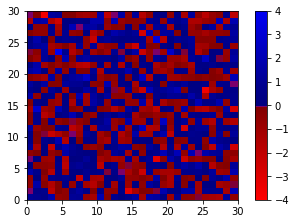

In [65]:
## Helper function for colorbar, (later)
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
from matplotlib import colors as mcol
#7A0085
vmax = 1.00



colorList = ['#ff0000', '#f20000','#e60000', '#d90000','#cc0000','#bf0000','#b30000','#a60000', '#990000', '#8c0000', '#850000', '#820000', '#7A0085',   '#000080'  ,  '#000082','#000085', '#00008c','#000099', '#0000a6','#0000b3','#0000bf','#0000cc','#0000d9','#0000e6','#0000f2', '#0000ff']
#["darkred","red","indianred","lightcoral","salmon","purple", "cornflowerblue", "mediumblue", "blue","darkblue"]
#No need for color list tbf, rgba for red is rgba(255, 0, 0, 1). Blue is rgba(0, 0, 255, 1). GOP -> e9141d. DEM -> 00aef3
cNode=[0.00,0.40,0.45, 0.474, 0.50, 0.525,0.55,0.60,1.00]
colorNode = [0.000,0.050,0.100,0.150,0.200,0.250,0.300,0.350,0.400,0.450, 0.474, 0.490, 0.500, 0.501, 0.525, 0.550,0.600,0.650,0.700,0.750,0.800,0.850,0.900,0.950,1.000]
x,y,c = zip(*np.random.rand(30,3)*4-2)

norm=plt.Normalize(min(colorNode),max(colorNode))
dupTuples = list(zip(cNode,cList))
tuples = list(zip(map(norm,colorNode), colorList))
coMap = LinearSegmentedColormap.from_list("", tuples)

#coMap = LinearSegmentedColormap.from_list('mycmap', [(0.00/vmax, mcol.to_rgba('red', alpha=1.00)),(0.10/vmax,mcol.to_rgba('red', alpha=0.10)),(0.20/vmax,mcol.to_rgba('red', alpha=0.10)),(0.30/vmax,mcol.to_rgba('red', alpha=0.10)),(0.40/vmax,mcol.to_rgba('red', alpha=0.20)),(0.50/vmax,'purple'),(0.60/vmax,mcol.to_rgba('blue', alpha=0.60)),(0.70/vmax,mcol.to_rgba('blue', alpha=0.70)),(0.80/vmax,mcol.to_rgba('blue', alpha=0.80)),(0.90/vmax,mcol.to_rgba('blue', alpha=0.90)), (1.00/vmax,mcol.to_rgba('blue', alpha=1.00)) ])

#norm=colors.BoundaryNorm(colorNode,coMap.N)
plot_examples([coMap])
#plt.scatter(x,y,c=c, cmap=coMap, norm=norm)
plt.show()

#colorList = ["red", "purple", "blue"]
#colorNode = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0]
##ColorMap = LinearSegmentedColormap.from_list("mycmap", list(zip(colorNode,colorList)))


In [ ]:
## Reverse colorLists 
lBlue = 

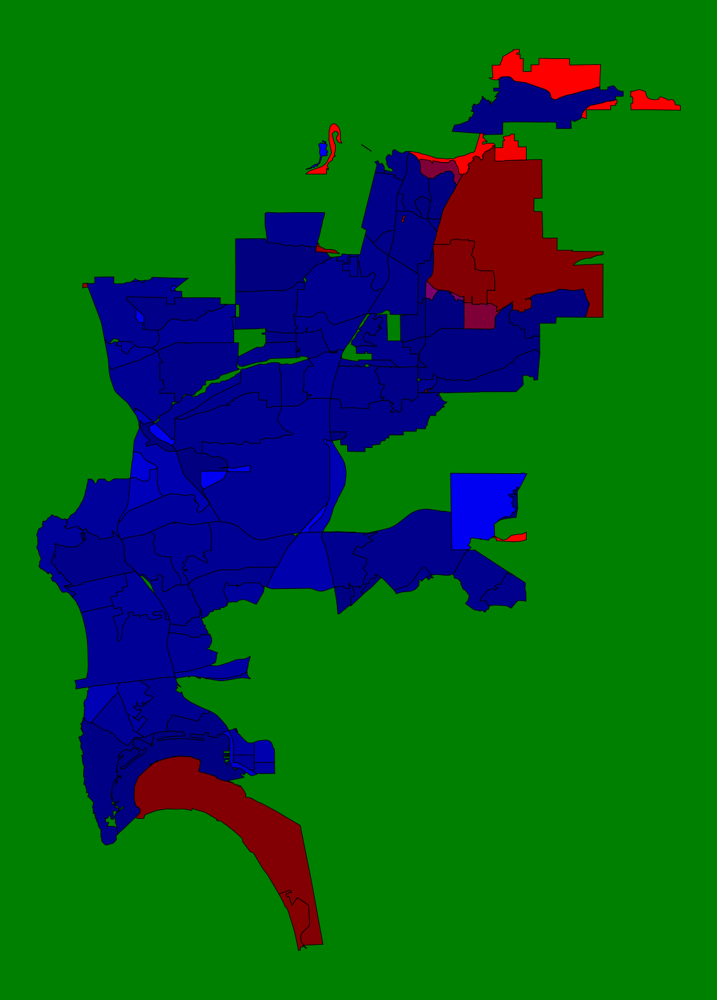

In [66]:
##Dict and voteshare calculated in DF can now be looped thru to fill in according to winning voteshare!

# Plot state and county + precinct lines first
x,y = plt.subplots(figsize=(20,50), facecolor='green')

#ca_precincts_G20.plot(ax=y, edgecolor='olive', linewidth=1.5, alpha=0.25, color='ivory')

#This one below is good for a sliding scale in b/w two candidates, but what about multiple candidates?
CD52_results.plot(ax=y, edgecolor='black', column='CDDEMSHARE', cmap=coMap, legend=False)
plt.axis('off')
plt.show()



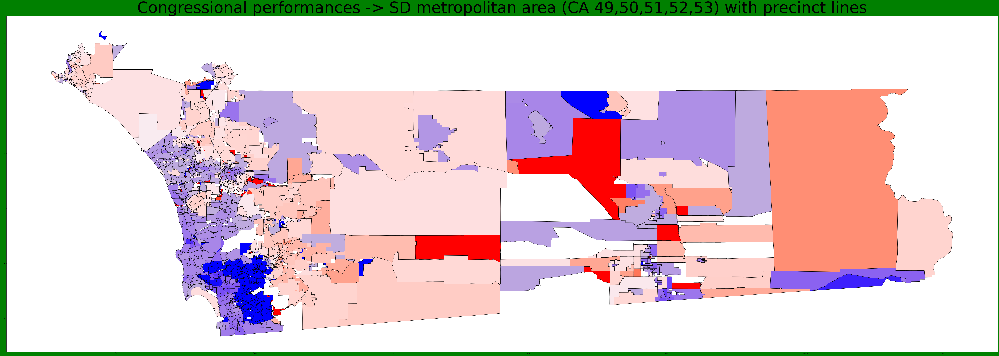

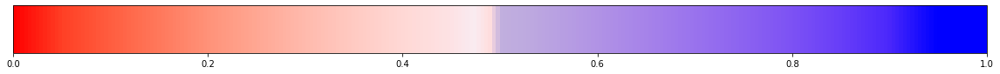

In [59]:
# Test for SD area results in a Cali ensconsed map. CAA 49, 50, 51, 52, 53. 52 already done

##Analyze results on a california constricted map, starting with presidential results by precinct first.
#Clean up COUNTY CODE as well, 
# SD COUNTY - 073, OC - 059, Imperial - 025, Riverside - 065

#The correct method seems to be to use bitwise operators
CD49_results = ca_G20_combined.query('CDDIST == "49" and (COUNTY == "073" | COUNTY == "059")')
CD50_results = ca_G20_combined.query('CDDIST == "50" and (COUNTY == "073" | COUNTY == "065")')
CD51_results = ca_G20_combined.query('CDDIST == "51" and (COUNTY == "073" | COUNTY == "025")')
CD53_results = ca_G20_combined.query('CDDIST == "53" and (COUNTY == "073" | COUNTY == "059")')


## We should be calculating the vote share of each party within the congressional district. We only have two parties for this. 
## First, calculate the congressional vote total
CD49_results['CDVOTE'] = CD49_results['CNGDEM01'] + CD49_results['CNGREP01']
CD50_results['CDVOTE'] = CD50_results['CNGDEM01'] + CD50_results['CNGREP01']
CD51_results['CDVOTE'] = CD51_results['CNGDEM01'] + CD51_results['CNGREP01']
CD53_results['CDVOTE'] = CD53_results['CNGDEM01'] + CD53_results['CNGREP01']



##Now, let's calculate voteshare of each party within this particular race
CD49_results['CDDEMSHARE'] = CD49_results['CNGDEM01']/CD49_results['CDVOTE']
CD49_results['CDREPSHARE'] = CD49_results['CNGREP01']/CD49_results['CDVOTE']

CD50_results['CDDEMSHARE'] = CD50_results['CNGDEM01']/CD50_results['CDVOTE']
CD50_results['CDREPSHARE'] = CD50_results['CNGREP01']/CD50_results['CDVOTE']


CD51_results['CDDEMSHARE'] = CD51_results['CNGDEM01']/CD51_results['CDVOTE']
CD51_results['CDREPSHARE'] = CD51_results['CNGREP01']/CD51_results['CDVOTE']

CD53_results['CDDEMSHARE'] = (CD53_results['CNGDEM02'])/CD53_results['CDVOTE']
CD53_results['CDREPSHARE'] = CD53_results['CNGDEM01']/CD53_results['CDVOTE']



## Now, we need to create a dictionary with colors corresponding to each party, and then decide whether to fill in red, blue (this will be useful method for primaries as well with multiple candidates)
#colorDict = {'Dem': 'Blue', 'Rep' : 'Red', 'Tie' : 'Grey'}

a,b = plt.subplots(figsize=(100,100), facecolor='green')

#ca_precincts_G20.plot(ax=y, edgecolor='olive', linewidth=1.5, alpha=0.25, color='ivory')

#This one below is good for a sliding scale in b/w two candidates, but what about multiple candidates?


#line for statewide map
#ca_G20_combined.plot(ax=b,edgecolor='black', alpha=0.015, color='white')
font = {'family':'sans-serif','color':'black','size':88}

plt.title("Congressional performances -> SD metropolitan area (CA 49,50,51,52,53) with precinct lines", fontdict=font)
I = CD49_results.plot(ax=b, edgecolor='black', column='CDDEMSHARE', cmap=coMap, facecolor='green', legend=False)

CD49_results.plot(ax=b, edgecolor='black', column='CDDEMSHARE', cmap=coMap, facecolor='green', legend=False)
CD50_results.plot(ax=b, edgecolor='black', column='CDDEMSHARE', cmap=coMap, facecolor='green', legend=False)
CD51_results.plot(ax=b, edgecolor='black', column='CDDEMSHARE', cmap=coMap,facecolor='green',  legend=False)
CD52_results.plot(ax=b, edgecolor='black', column='CDDEMSHARE', cmap=coMap,facecolor='green',  legend=False)
CD53_results.plot(ax=b, edgecolor='black', column='CDDEMSHARE', cmap=coMap,facecolor='green', vmin=0.0,vmax=1.0, legend=False)

#a.colorbar(im, ax=b)
fig,ax = plt.subplots(figsize=(20,1))
#cb1 = b.imshow(I,cmap=coMap)
cBar = mpl.colorbar.ColorbarBase(ax, cmap=coMap,
                                norm=norm,
                                orientation='horizontal')
#a.colorbar(cBar, ax=b)
fig.show()
#

<AxesSubplot:title={'center':'Congressional performances 2020 -> SD metropolitan area (CA 49,50,51,52,53)'}>

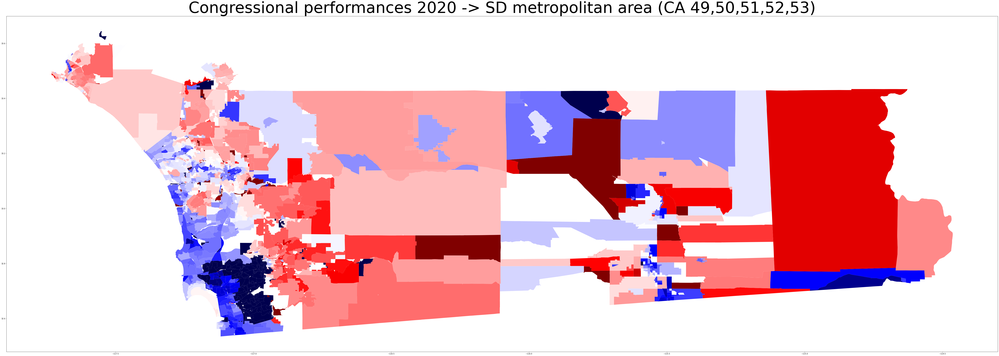

In [51]:
x,y = plt.subplots(figsize=(100,100))
plt.title("Congressional performances 2020 -> SD metropolitan area (CA 49,50,51,52,53)", fontdict=font)

CD49_results.plot(ax=y,  column='CDDEMSHARE', cmap='seismic_r', vmin=0.0,vmax=1.0, legend=False)
CD50_results.plot(ax=y,  column='CDDEMSHARE', cmap='seismic_r', vmin=0.0,vmax=1.0, legend=False)
CD51_results.plot(ax=y,  column='CDDEMSHARE', cmap='seismic_r', vmin=0.0,vmax=1.0, legend=False)
CD52_results.plot(ax=y, column='CDDEMSHARE', cmap='seismic_r', vmin=0.0,vmax=1.0, legend=False)
CD53_results.plot(ax=y,  column='CDDEMSHARE', cmap='seismic_r', vmin=0.0,vmax=1.0, legend=False)


<AxesSubplot:title={'center':'Congressional performances 2020 -> SD metropolitan area (CA 49,50,51,52,53)'}>

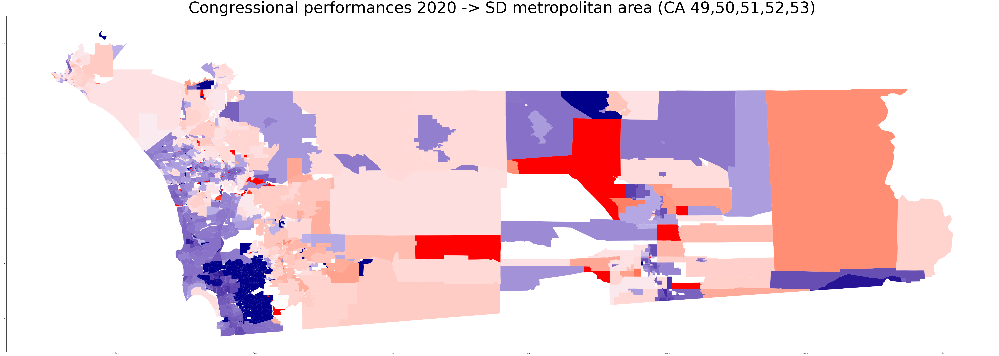

In [52]:
###With new colormap, good comparison

x,y = plt.subplots(figsize=(100,100))
plt.title("Congressional performances 2020 -> SD metropolitan area (CA 49,50,51,52,53)", fontdict=font)

CD49_results.plot(ax=y,  column='CDDEMSHARE', cmap=coMap,  legend=False)
CD50_results.plot(ax=y,  column='CDDEMSHARE', cmap=coMap,  legend=False)
CD51_results.plot(ax=y,  column='CDDEMSHARE', cmap=coMap,  legend=False)
CD52_results.plot(ax=y, column='CDDEMSHARE', cmap=coMap, legend=False)
CD53_results.plot(ax=y,  column='CDDEMSHARE', cmap=coMap, vmin=0.0,vmax=1.0 ,legend=False)




In [53]:
#Now that we have some congressional performances for our area (SD metro), we're first going to plot presidential results, and then calculate overperformance
#There were also 25 ballot propositions throughout the state, some of them fairly important and it'd be cool to run some regressions on these. 

##Some of the propositions I'm personally interested and invested in, and would like to take a closer look at in terms of both demographics and voter patterns are
#### CA Prop 14 -> stem cell research (R&D funding + soft assay into pro-life questions)
#### CA Prop 21 -> Expanding local authority on rent control (ppl do it for zoning, and this is an injustice, but would be interesting to see the results and where the potential is.)
#  props 16, 20 (reverses 47), 24 (anti-trust regulation for consumers), 25 (cash bail). 22 was ruled unconstitutional thank FUCK <sometimes direct democracy works fkin wonders eh? prolly trial and error for better or worse>
## write strat later.



#### 2020 general election results for SoCal. ####

## We should be calculating the vote share of each party within the congressional district. We only have two parties for this. 
## First, calculate the presidential vote total. (3rd parties are AIP,GRN,LIB,PAF)
CD49_results['PRESVOTE'] = CD49_results['PRSDEM01'] + CD49_results['PRSREP01'] + CD49_results['PRSAIP01'] + CD49_results['PRSGRN01'] + CD49_results['PRSLIB01'] + CD49_results['PRSPAF01']
CD50_results['PRESVOTE'] = CD50_results['PRSDEM01'] + CD50_results['PRSREP01'] + CD50_results['PRSAIP01'] + CD50_results['PRSGRN01'] + CD50_results['PRSLIB01'] + CD50_results['PRSPAF01']
CD51_results['PRESVOTE'] = CD51_results['PRSDEM01'] + CD51_results['PRSREP01'] + CD51_results['PRSAIP01'] + CD51_results['PRSGRN01'] + CD51_results['PRSLIB01'] + CD51_results['PRSPAF01']
CD52_results['PRESVOTE'] = CD52_results['PRSDEM01'] + CD52_results['PRSREP01'] + CD52_results['PRSAIP01'] + CD52_results['PRSGRN01'] + CD52_results['PRSLIB01'] + CD52_results['PRSPAF01']
CD53_results['PRESVOTE'] = CD53_results['PRSDEM01'] + CD53_results['PRSREP01'] + CD53_results['PRSAIP01'] + CD53_results['PRSGRN01'] + CD53_results['PRSLIB01'] + CD53_results['PRSPAF01']


##Now, let's calculate voteshare of each party within this particular race (do 2 party first, and then potential left wing later?)
CD49_results['PRESDEMSHARE'] = CD49_results['PRSDEM01']/CD49_results['PRESVOTE']
CD49_results['PRESREPSHARE'] = CD49_results['PRSREP01']/CD49_results['PRESVOTE']

CD50_results['PRESDEMSHARE'] = CD50_results['PRSDEM01']/CD50_results['PRESVOTE']
CD50_results['PRESREPSHARE'] = CD50_results['PRSREP01']/CD50_results['PRESVOTE']


CD51_results['PRESDEMSHARE'] = CD51_results['PRSDEM01']/CD51_results['PRESVOTE']
CD51_results['PRESREPSHARE'] = CD51_results['PRSREP01']/CD51_results['PRESVOTE']

CD52_results['PRESDEMSHARE'] = CD52_results['PRSDEM01']/CD52_results['PRESVOTE']
CD52_results['PRESREPSHARE'] = CD52_results['PRSREP01']/CD52_results['PRESVOTE']


CD53_results['PRESDEMSHARE'] = CD53_results['PRSDEM01']/CD53_results['PRESVOTE']
CD53_results['PRESREPSHARE'] = CD53_results['PRSREP01']/CD53_results['PRESVOTE']





<AxesSubplot:title={'center':'Presidential performance by CD 2020 -> SD metropolitan area (CA 49,50,51,52,53)'}>

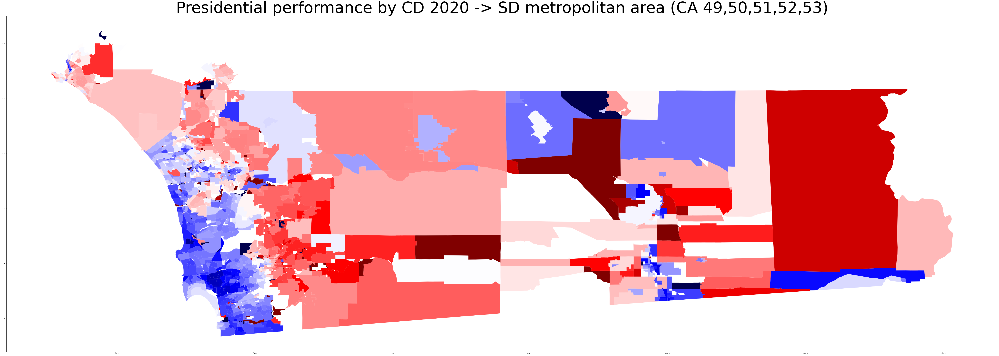

In [54]:
CD49_results

x,y = plt.subplots(figsize=(100,100))
plt.title("Presidential performance by CD 2020 -> SD metropolitan area (CA 49,50,51,52,53)", fontdict=font)

CD49_results.plot(ax=y,  column='PRESDEMSHARE', cmap='seismic_r', vmin=0.0,vmax=1.0, legend=False)
CD50_results.plot(ax=y,  column='PRESDEMSHARE', cmap='seismic_r', vmin=0.0,vmax=1.0, legend=False)
CD51_results.plot(ax=y,  column='PRESDEMSHARE', cmap='seismic_r', vmin=0.0,vmax=1.0, legend=False)
CD52_results.plot(ax=y, column='PRESDEMSHARE', cmap='seismic_r', vmin=0.0,vmax=1.0, legend=False)
CD53_results.plot(ax=y,  column='PRESDEMSHARE', cmap='seismic_r', vmin=0.0,vmax=1.0, legend=False)


<AxesSubplot:title={'center':'Presidential performance by CD 2020 -> SD metropolitan area (CA 49,50,51,52,53)'}>

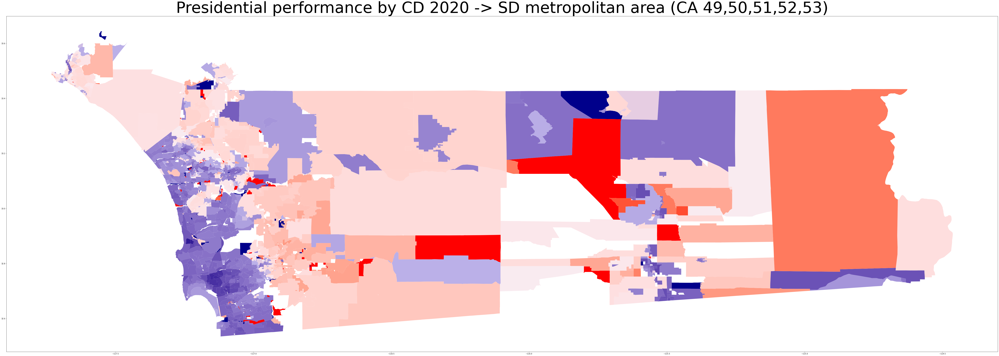

In [55]:
#Pres share using custom colormap, good comparison
x,y = plt.subplots(figsize=(100,100))
plt.title("Presidential performance by CD 2020 -> SD metropolitan area (CA 49,50,51,52,53)", fontdict=font)

CD49_results.plot(ax=y, column='PRESDEMSHARE', cmap=coMap,  legend=False)
CD50_results.plot(ax=y,  column='PRESDEMSHARE', cmap=coMap,  legend=False)
CD51_results.plot(ax=y,  column='PRESDEMSHARE', cmap=coMap,  legend=False)
CD52_results.plot(ax=y, column='PRESDEMSHARE', cmap=coMap, legend=False)
CD53_results.plot(ax=y,  column='PRESDEMSHARE', cmap=coMap,  legend=False)


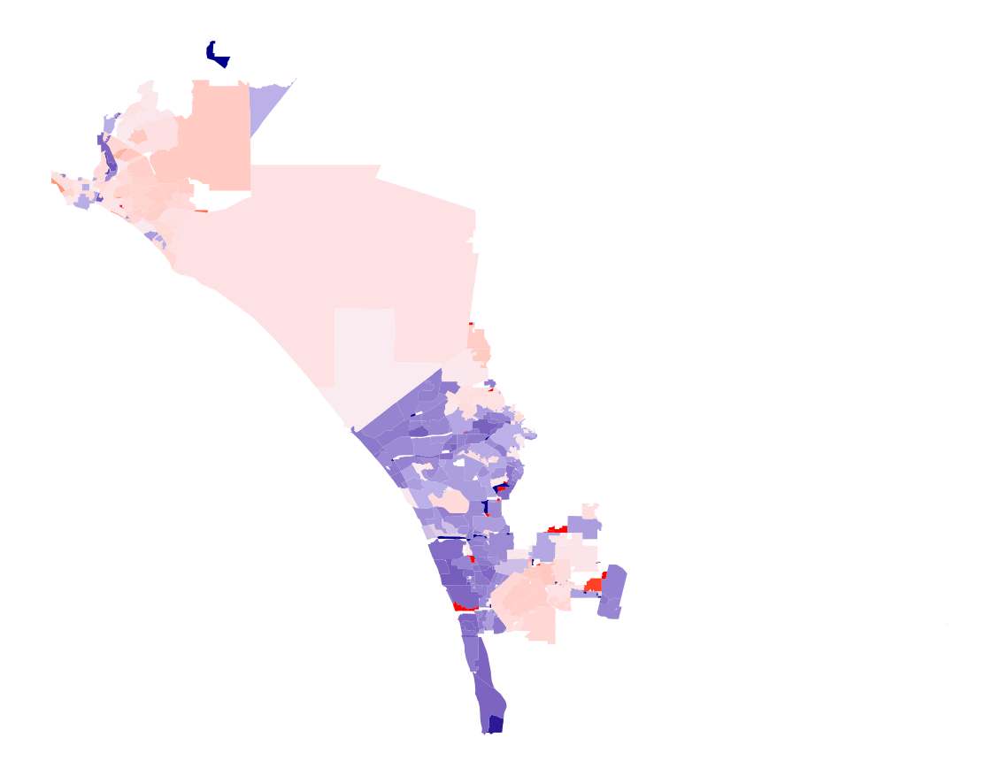

In [56]:
##Plotting and testing individual CD's out

x,y = plt.subplots(figsize=(20,50), facecolor='white')

#ca_precincts_G20.plot(ax=y, edgecolor='olive', linewidth=1.5, alpha=0.25, color='ivory')

#This one below is good for a sliding scale in b/w two candidates, but what about multiple candidates?
CD49_results.plot(ax=y, column='CDDEMSHARE', cmap=coMap, legend=False)
plt.axis('off')
plt.show()
